# World Data League 2021
## Notebook Template

> This notebook is one of the mandatory deliverables when you submit your solution (alongside the video pitch). Its structure follows the WDL evaluation criteria and it has dedicated cells where you can add descriptions. Make sure your code is readable as it will be the only technical support the jury will have to evaluate your work.

> The notebook must:
    *   💻 have all the code that you want the jury to evaluate
    *   🧱 follow the predefined structure
    *   📄 have markdown descriptions where you find necessary
    *   👀 be saved with all the output that you want the jury to see
    *   🏃‍♂️ be runnable


## Introduction ℹ️
> Describe how you framed the challenge by telling us what problem are you trying to solve and how your solution solves that problem.

### Research 🕵🏽‍♂️

Before starting to think about the problem solution, we did a research to know a bit more about the state of art in public transport,churn and Portugal.
Below, some of the most interesting links:

+ [Customer Churn: The Missing Link in Public Transport Marketing](https://www.australasiantransportresearchforum.org.au/sites/default/files/ATRF2017_056.pdf)
+ [Customer Loyalty in the public transportation context](https://dspace.mit.edu/handle/1721.1/58083)
+ [Understading Mobility Patterns in Portugal during Pandemics](https://www.uc.pt/covid19/documentos/DataDrivenApproachtoUnderstandtheMobilityPatternsofthePortuguesePopulationduringtheCOVID19Pandemic)
+ [Why people are not using Public Transport?](https://www.thespruce.com/public-transportation-reasons-people-hate-it-1709096)
+ [Understanding Why Some People Do Not Use Buses in Scotland](https://www.gov.scot/binaries/content/documents/govscot/publications/research-and-analysis/2010/04/understanding-people-use-buses/documents/0097941-pdf/0097941-pdf/govscot%3Adocument/0097941.pdf)]

This information helped us to understand better the business case and develop a problem solution based on real insights. <br>


### Business Understanding 🧠

In [188]:
from IPython.display import IFrame

In [137]:
Link  = 'https://docs.google.com/spreadsheets/d/1raxirUFJQLwvHmCPEMXJn0l-15iFB1Q7JO7mkKMlXQU/edit#gid=306848164'
IFrame(Link, width = '100%', height = 400)

<br>

#### Business Questions and Answers ❓

**Key goal for the project?**:
+ Reduce churn in the public transport

**Why it is important to reduce that churn?**
+ Less pollution and noise -> cities more sustainable 
+ Less traffic and time loss in the city. More safety included
+ Less car space is required (road, parking, garage...)


**How can we achieve this goal?**
+ Identify churn profiles and drivers
+ Propose measures to win back lost segments
+ Estimate the impact of the measures

***

<br>

#### Problem Approach:
    
**Two Scenarios**:
The actual situation is strongly affected by the World Pandemic, and this it is a key factor for our bussines case:

+ **Scenario 1: During Covid** The pandemic effect is very important, and the health factor is essential. Public Transport can be a dangerous point for infections. Besides, in this scenario de traffic is very low as we can see in [Portugal](https://www.tomtom.com/en_gb/traffic-index/portugal-traffic/): [Lisbon](https://www.tomtom.com/en_gb/traffic-index/lisbon-traffic/) and [Porto](https://www.tomtom.com/en_gb/traffic-index/porto-traffic/). For this reason, we want to reduce the churn in this period, but it is important keep the health recommendations and avoid too many passengers on the bus (2m of distance)

+ **Scenario 2: After Covid** The situation would be close to the normality before Covid, but some effects will still remain, due to the importance of the pandemic. Here, we are going to do multiple actions to bring back clients to the public transport. 

**Churn Classification:**

**Churn Type 1** The trip is not happening:

+ Lack of People:
    + Tourism: Specially by plane
    + Out of the cities: A lot of people left big cities where there are more public transport 
    
+ Lack of trip:
    + Less leisure planning
    + Work from Home policy
    
**Churn Type 2** The trip is happening but it is not efficient/possible with Public Transport:
+ Routes:
    + Destination/Origin can be very far from the bus stop
    + Combination of the route (When you have to change line 
    + Inefficiencies Route (The road to the destination is too long)
    
+ Time:
    + Low Speed: Bus can be a bit slow if you compare with another vehicle
    + Low Frequency: For specific routes, the public transport freq can be low and passengers should wait a lot for the trip
    + Time gaps: Sometimes, there is no public transport in the night and people could not use the transport 
    
**Churn type 3**: The trip is happening but the user prefer other option. They can be related among them.

+ Competitors
    + Own Vehicle: The main competitor for users, and one of the
    + Micromobility Solutions: cycle, motorbike, scooter
    + Road Vehicle: Ride-Hailing and Taxi
    + Other public transport: Train, subway

+ Service
    + Ambiance: Temperature, cleaning, number of passengers...
    + Safety: Crime and offenses on the bus or bus station
    + Healthy: Healthy factors, (now specially important with coronavirus
    + Other Factors: lack of information, payment methods
    
+ Personal Factors
    + Economic: Price of the ticket
    + Demographic: Demography factors: age, demography, culture
    + Social: Status

+ Bad Experiences:
    + Punctuality
    + Technical Error

**Factors to consider**

+ Pay attention to places with more traffic and pollution
+ Reduce the churn for long trips since they are worse for traffic and pollution 
+ Consider the competitor/reason for churn: If the client prefers another public transport is less important than if the user goes by car
<br>

### Data Understading 📖 

We are going to divide the data input into two big parts, as it is normal in the Data Science projects:

**Internal Data Sources**:
+ O/D Matrix:
+ User Profile with Churn:

    
**External Data Sources**:
+ Geospatial Data: Open Street Maps
+ Demographic Data: Dados Abiertos
+ Mobility Data: Google Mobility
+ Weather/pollution: 

<hr>
<br>


## Development

> Start coding here! 🐱‍🏍.Don't hesitate to create markdown cells to include descriptions of your work where you see fit, as well as commenting your code. We know that you know exactly where to start when it comes to crunching data and building models, but don't forget that WDL is all about social impact...so take that into consideration as well.



### Introduction to Development

#### Dependencies

In [100]:
import folium
import pandas as pd
import geopandas as gpd

from pathlib import Path
from typing import List
from branca.colormap import linear, LinearColormap


import osmnx as ox
import geocoder
from haversine import haversine_vector, Unit

import os
from pathlib import Path
import folium
from folium import plugins

from pathlib import Path
from category_encoders import OneHotEncoder
from sklearn import set_config
from sklearn.pipeline import make_pipeline
from sklearn.compose import make_column_transformer
from sklearn.impute import SimpleImputer
from catboost import CatBoostRegressor, CatBoostClassifier

#sys.path.append('../scripts')

pd.options.plotting.backend = 'plotly'
import shap

#### Constants

In [4]:
# Paths
PATH_EXECUTION = (
    Path('..') if Path('.').resolve().name == 'notebooks'
    else Path('.')
)

PATH_DATA = PATH_EXECUTION / 'data'
PATH_MAPS = PATH_EXECUTION / 'maps'

# Some urls with data and descriptions
URL_DATA_USERS_PROFILE = (
    'https://wdl-data.fra1.digitaloceanspaces.com/pse/Churn_UsersProfile.txt'
)

URL_DATA_CHURN_ORIGIN_DESTINATION = (
    'https://wdl-data.fra1.digitaloceanspaces.com/pse/Churn_OD.txt'
)

URL_DESCRIPTION_USERS_PROFILE = (
    'https://wdl-data.fra1.digitaloceanspaces.com/'
    'pse/stage_1_challenge_1_dictionary.xlsx'
)

URL_DESCRIPTION__CHURN_ORIGIN_DESTINATION = (
    'https://wdl-data.fra1.digitaloceanspaces.com/'
    'pse/stage_1_challenge_1_dictionary.xlsx'
)

# Coordinates from Google Maps
CITY_CENTERS = dict(lisbon=[38.7436883, -9.1952226],
                    porto=[41.1622023,-8.656973])

# Needed for geopandas
CRS = 'EPSG:4326'

# The Hitchhiker's Guide to the Galaxy
RANDOM_STATE = 42

## Data Loading (and Extracting)

### Internal Data

In [6]:
df_users_profile = (
    pd
    .read_csv(URL_DATA_USERS_PROFILE, sep='|', encoding='latin1')
    .rename(columns=lambda column: column.lower())
)

df_churn_origin_destination = (
    pd
    .read_csv(URL_DATA_CHURN_ORIGIN_DESTINATION, sep='|', encoding='latin1')
    .rename(columns=lambda column: column.lower())
)

df_users_profile_description = (
    pd
    .read_excel(URL_DESCRIPTION_USERS_PROFILE, skiprows=1)
    .rename(columns=lambda column: column.lower())
)

df_churn_origin_destination_description = (
    pd
    .read_excel(URL_DESCRIPTION__CHURN_ORIGIN_DESTINATION, skiprows=1)
    .rename(columns=lambda column: column.lower())
)

Your version of xlrd is 1.2.0. In xlrd >= 2.0, only the xls format is supported. As a result, the openpyxl engine will be used if it is installed and the engine argument is not specified. Install openpyxl instead.
Your version of xlrd is 1.2.0. In xlrd >= 2.0, only the xls format is supported. As a result, the openpyxl engine will be used if it is installed and the engine argument is not specified. Install openpyxl instead.


**Users profile description and 5 random samples**

In [7]:
display(df_users_profile_description.transpose())

df_users_profile.sample(5, random_state=RANDOM_STATE).style.hide_index().set_caption('Five Random Samples')

,0,1,2,3,4,5,6,7
column name,Region_of_Origin,District_of_Origin,County_of_Origin,Region_of_Public_Transportation,District_of_Public_Transportation,County_of_Public_Transportation,Dicofre_ParishCode_of_Public_Transportation,Demand_weight
description,Region Of Origin,Distritct of Origin,County of Origin,Region Of Public Transportation,District Of Public Transportation,County Of Public Transportation,Parish Code Of Public Transportation,Demand's Weight of Public Transportation in ea...
type,String,String,String,String,String,String,String,Real
example,R1 - AM Lisboa,Lisboa,Amadora,R1 - AM Lisboa,LISBOA,LISBOA,110608,0.307


region_of_origin,district_of_origin,county_of_origin,period,genderdescription,ageclassdescription,average_bususers_per_day
R2 - AM Porto,Porto,Gondomar,Sep-20 to Jan-21,Male,15-24,126.654141
R1 - AM Lisboa,Lisboa,Amadora,Sep-20 to Jan-21,Female,35-44,478.337192
R1 - AM Lisboa,Setúbal,Alcochete,Sep-20 to Jan-21,Male,55-64,37.446537
R2 - AM Porto,Porto,Vila do Conde,Sep-20 to Jan-21,Male,55-64,74.179387
R2 - AM Porto,Porto,Vila Nova de Gaia,Sep-20 to Jan-21,Male,45-54,1443.335763


**Churn origin-destination description and 5 random samples**

In [8]:
display(df_churn_origin_destination_description)

df_churn_origin_destination.sample(5, random_state=RANDOM_STATE).style.hide_index().set_caption('Five Random Samples')

,column name,description,type,example
0,Region_of_Origin,Region Of Origin,String,R1 - AM Lisboa
1,District_of_Origin,Distritct of Origin,String,Lisboa
2,County_of_Origin,County of Origin,String,Amadora
3,Region_of_Public_Transportation,Region Of Public Transportation,String,R1 - AM Lisboa
4,District_of_Public_Transportation,District Of Public Transportation,String,LISBOA
5,County_of_Public_Transportation,County Of Public Transportation,String,LISBOA
6,Dicofre_ParishCode_of_Public_Transportation,Parish Code Of Public Transportation,String,110608
7,Demand_weight,Demand's Weight of Public Transportation in ea...,Real,0.307


region_of_origin,district_of_origin,county_of_origin,region_of_public_transportation,district_of_public_transportation,county_of_public_transportation,dicofre_parishcode_of_public_transportation,demand_weight
R2 - AM Porto,Porto,Paredes,R1 - AM Lisboa,LISBOA,LISBOA,110607,0.000146
R2 - AM Porto,Aveiro,Espinho,R2 - AM Porto,PORTO,PORTO,131203,0.001927
R2 - AM Porto,Porto,Vila do Conde,R1 - AM Lisboa,LISBOA,LISBOA,110657,0.003064
R1 - AM Lisboa,Lisboa,Sintra,R1 - AM Lisboa,LISBOA,LOURES,110726,0.001727
R1 - AM Lisboa,Lisboa,Odivelas,R1 - AM Lisboa,LISBOA,OEIRAS,111002,0.000001


### External Data

#### Open Street Maps

In [10]:
list_cities = df_users_profile.county_of_origin.unique()
df_city = pd.DataFrame()
for city_aux in list_cities:
    print(city_aux + ' - ', sep=' ', end='', flush=True)
    g = geocoder.osm(city_aux + ',  Portugal')
    df_city_aux = pd.DataFrame.from_dict(g.json).head(1).reset_index(drop = True)
    df_city_aux['city'] = city_aux
    df_city = pd.concat([df_city, df_city_aux]).reset_index(drop = True)


Amadora - Cascais - Lisboa - Loures - Mafra - Odivelas - Oeiras - Sintra - Vila Franca de Xira - Alcochete - Almada - Barreiro - Moita - Montijo - Palmela - Seixal - Sesimbra - Setúbal - Espinho - Oliveira de Azeméis - Santa Maria da Feira - Gondomar - Maia - Matosinhos - Paredes - Porto - Póvoa de Varzim - Santo Tirso - Trofa - Valongo - Vila do Conde - Vila Nova de Gaia - Arouca - São João da Madeira - Vale de Cambra - 

In [11]:
df_bus = pd.DataFrame()
query_public_transport_bus =  {'amenity' : 'bus_station', 'highway': 'bus_stop'}
import time
for city_aux in list_cities:
    print(city_aux + ' - ', sep=' ', end='', flush=True)
    df_bus_aux = ox.geometries.geometries_from_place(city_aux + ', Portugal', tags = query_public_transport_bus)
    df_bus_aux['city'] = city_aux
    df_bus = pd.concat([df_bus, df_bus_aux], ignore_index = True)
    time.sleep(1)

Amadora - Cascais - Lisboa - Loures - Mafra - Odivelas - Oeiras - Sintra - Vila Franca de Xira - Alcochete - Almada - Barreiro - Moita - Montijo - Palmela - Seixal - Sesimbra - Setúbal - Espinho - Oliveira de Azeméis - Santa Maria da Feira - Gondomar - Maia - Matosinhos - Paredes - Porto - Póvoa de Varzim - Santo Tirso - Trofa - Valongo - Vila do Conde - Vila Nova de Gaia - Arouca - São João da Madeira - Vale de Cambra - 

#### Pollution Data from Weather

In [46]:
DATA_PATH = Path('../data')
list(DATA_PATH.glob('*'))

[PosixPath('../data/google_trends.csv'),
 PosixPath('../data/master_table.csv'),
 PosixPath('../data/airports.csv'),
 PosixPath('../data/google_mobility.csv'),
 PosixPath('../data/df_covid.csv'),
 PosixPath('../data/portugal_completo_procesado.csv'),
 PosixPath('../data/portugal_completo_raw.csv'),
 PosixPath('../data/pollution_data.csv'),
 PosixPath('../data/df_city.csv'),
 PosixPath('../data/master_data_test.csv'),
 PosixPath('../data/.ipynb_checkpoints'),
 PosixPath('../data/portugal_basico_procesado.csv'),
 PosixPath('../data/df_bus.csv'),
 PosixPath('../data/parishes'),
 PosixPath('../data/distancias.csv'),
 PosixPath('../data/df_bus_county.csv'),
 PosixPath('../data/portugal_completo_clean.csv')]

# UP - OD

In [50]:
df_up_od = df_up.merge(
    df_od, how='left'
)
print(df_up_od.shape)
# Esto solo es válido si suponemos los mismos pesos en las routas para todos los segmentos demográficos
df_up_od['average_bususers_per_day_route'] = (
    df_up_od['average_bususers_per_day'] * df_up_od['demand_weight']
)
df_up_od.head()

(40422, 12)


,region_of_origin,district_of_origin,county_of_origin,period,genderdescription,ageclassdescription,average_bususers_per_day,region_of_public_transportation,district_of_public_transportation,county_of_public_transportation,dicofre_parishcode_of_public_transportation,demand_weight,average_bususers_per_day_route
0,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,R1 - AM Lisboa,Lisboa,Lisboa,110608.0,0.307323,90.412646
1,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,R1 - AM Lisboa,Lisboa,Lisboa,110639.0,0.069997,20.592712
2,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,R1 - AM Lisboa,Lisboa,Lisboa,110658.0,0.066059,19.434175
3,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,R1 - AM Lisboa,Lisboa,Lisboa,110654.0,0.059847,17.606641
4,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,R1 - AM Lisboa,Lisboa,Lisboa,110633.0,0.052341,15.398419


In [51]:
df_routes_weight = (
    df_od
    .groupby(['county_of_origin', 'county_of_public_transportation'], as_index=False)
    .demand_weight
    .sum()
)

df_up_routes_weight_merged = (df_up
 .merge(df_routes_weight,
        on='county_of_origin'))

df_up_routes_weight_merged['average_bususers_per_day_route'] = (
    df_up_routes_weight_merged['average_bususers_per_day'] * df_up_routes_weight_merged['demand_weight']
)

# Información demográfica

In [52]:
population = pd.read_csv(DATA_PATH / 'portugal_completo_procesado.csv').rename(columns={
    'county': 'county_of_origin'
})
print(population.shape)
population.head()

(4032, 4)


,county_of_origin,genderdescription,ageclassdescription,population
0,Abrantes,Female,15-24,1594.0
1,Abrantes,Female,25-34,1459.0
2,Abrantes,Female,35-44,2134.0
3,Abrantes,Female,45-54,2574.0
4,Abrantes,Female,55-64,2765.0


In [58]:
population

,county_of_origin,genderdescription,ageclassdescription,population
0,Abrantes,Female,15-24,1594.0
1,Abrantes,Female,25-34,1459.0
2,Abrantes,Female,35-44,2134.0
3,Abrantes,Female,45-54,2574.0
4,Abrantes,Female,55-64,2765.0
...,...,...,...,...
4027,Óbidos,Male,25-34,612.0
4028,Óbidos,Male,35-44,748.0
4029,Óbidos,Male,45-54,822.0
4030,Óbidos,Male,55-64,787.0


In [61]:
df_up_od_population = df_up_routes_weight_merged.merge(population, how='left')
df_up_od_population.shape

(7823, 11)

# Distancias

In [62]:
distancias = pd.read_csv(DATA_PATH / 'distancias.csv').rename(columns={'value': 'distance'})
print(distancias.shape)
distancias.head()

(1225, 3)


,origin,variable,distance
0,Amadora,Amadora,0.00
1,Cascais,Amadora,19.69
2,Lisboa,Amadora,11.23
3,Loures,Amadora,12.04
4,Mafra,Amadora,22.68


In [63]:
df_population_distance = df_up_od_population.merge(
    distancias, how='left', 
    left_on=['county_of_origin', 'county_of_public_transportation'],
    right_on=['origin', 'variable']
).drop(columns=['origin', 'variable'])
df_population_distance.shape

(7823, 12)

# Mergear con df_city latitud y longitud

# Pollution

In [64]:
pollution = pd.read_csv(DATA_PATH / 'pollution_data.csv')
pollution['date'] = pd.to_datetime(pollution['date'])
print(pollution.shape)
pollution.head()

(56245, 11)


,date,co,no,no2,o3,so2,pm2_5,pm10,nh3,aqi,county
0,2020-11-25 02:00:00,200.27,0.0,4.07,80.11,2.09,4.67,5.31,0.09,2,Amadora
1,2020-11-25 03:00:00,198.60,0.0,3.56,80.11,1.76,3.72,4.27,0.10,2,Amadora
2,2020-11-25 04:00:00,200.27,0.0,3.34,79.39,1.61,2.38,2.90,0.13,1,Amadora
3,2020-11-25 05:00:00,200.27,0.0,3.43,77.96,1.62,1.78,2.27,0.16,1,Amadora
4,2020-11-25 06:00:00,201.94,0.0,3.77,72.24,1.79,1.81,2.33,0.18,1,Amadora


In [65]:
from sklearn.preprocessing import StandardScaler

pollution = pollution.loc[pollution['date'].dt.hour.between(7, 20)]

scaler = StandardScaler()
pollution_scaled = pollution.drop(columns = ["date", "aqi", "county"])
pollution_scaled = scaler.fit_transform(pollution_scaled)
pollution_scaled_df = pd.DataFrame(pollution_scaled, columns = pollution.select_dtypes("float").columns)
display(pollution_scaled_df.shape)
pollution_scaled_df = pd.concat(
    [pollution[["date", "county"]].reset_index(drop = True), pollution_scaled_df], axis = 1
)
pollution_scaled_df["timestamp_mean"] = pollution_scaled_df.drop(columns = ["date", "county"]).mean(axis = 1)
#pollution_grouped = pollution_scaled_df.groupby("county").agg({"timestamp_mean": ["median", "max"]})
pollution_grouped = pollution_scaled_df.groupby("county").agg(
    median_pollution = ("timestamp_mean", "median"), 
    max_pollution = ("timestamp_mean", "max")
)
#pollution_grouped.columns = pollution_grouped.columns.droplevel()
pollution_grouped = pollution_grouped.reset_index()
pollution_grouped.sort_values(by = ["median_pollution"], ascending = False)

(32830, 8)

,county,median_pollution,max_pollution
33,Vila Nova de Gaia,-0.032564,6.266074
20,Porto,-0.032564,6.266074
7,Gondomar,-0.032564,6.266074
11,Maia,-0.032564,6.266074
12,Matosinhos,-0.032564,6.266074
15,Odivelas,-0.074655,8.266864
2,Amadora,-0.074655,8.266864
8,Lisboa,-0.074655,8.266864
9,Loures,-0.074655,8.266864
16,Oeiras,-0.074655,8.266864


In [66]:
df_population_distance_pollution = df_population_distance.merge(
    pollution_grouped, how = "left", left_on = "county_of_origin", right_on = "county"
).merge(
    pollution_grouped, how = "left", left_on = "county_of_public_transportation", right_on = "county", suffixes = ("_origin", "_destination")
).drop(columns = ["county_origin", "county_destination"])

df_population_distance_pollution.head()

,region_of_origin,district_of_origin,county_of_origin,period,genderdescription,ageclassdescription,average_bususers_per_day,county_of_public_transportation,demand_weight,average_bususers_per_day_route,population,distance,median_pollution_origin,max_pollution_origin,median_pollution_destination,max_pollution_destination
0,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,Almada,0.000282,0.082963,8782.0,11.21,-0.074655,8.266864,-0.086260,4.622488
1,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,Amadora,0.059090,17.383936,8782.0,0.00,-0.074655,8.266864,-0.074655,8.266864
2,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,Gondomar,0.000005,0.001471,8782.0,272.56,-0.074655,8.266864,-0.032564,6.266074
3,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,Lisboa,0.913746,268.818779,8782.0,11.23,-0.074655,8.266864,-0.074655,8.266864
4,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,Loures,0.001792,0.527196,8782.0,12.04,-0.074655,8.266864,-0.074655,8.266864


In [67]:
(df_population_distance_pollution
             .drop(columns = ["average_bususers_per_day_route", "period", 'demand_weight', 'average_bususers_per_day'])
             .columns.to_list())

['region_of_origin',
 'district_of_origin',
 'county_of_origin',
 'genderdescription',
 'ageclassdescription',
 'county_of_public_transportation',
 'population',
 'distance',
 'median_pollution_origin',
 'max_pollution_origin',
 'median_pollution_destination',
 'max_pollution_destination']

In [68]:
df_population_distance_pollution

,region_of_origin,district_of_origin,county_of_origin,period,genderdescription,ageclassdescription,average_bususers_per_day,county_of_public_transportation,demand_weight,average_bususers_per_day_route,population,distance,median_pollution_origin,max_pollution_origin,median_pollution_destination,max_pollution_destination
0,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,Almada,0.000282,0.082963,8782.0,11.21,-0.074655,8.266864,-0.086260,4.622488
1,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,Amadora,0.059090,17.383936,8782.0,0.00,-0.074655,8.266864,-0.074655,8.266864
2,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,Gondomar,0.000005,0.001471,8782.0,272.56,-0.074655,8.266864,-0.032564,6.266074
3,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,Lisboa,0.913746,268.818779,8782.0,11.23,-0.074655,8.266864,-0.074655,8.266864
4,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,Loures,0.001792,0.527196,8782.0,12.04,-0.074655,8.266864,-0.074655,8.266864
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7818,R2 - AM Porto,Aveiro,Vale de Cambra,Sep-20 to Jan-21,Male,65+,2458.667434,Gondomar,0.017432,42.859491,2364.0,35.43,-0.305390,1.989528,-0.032564,6.266074
7819,R2 - AM Porto,Aveiro,Vale de Cambra,Sep-20 to Jan-21,Male,65+,2458.667434,Lisboa,0.692551,1702.752590,2364.0,249.47,-0.305390,1.989528,-0.074655,8.266864
7820,R2 - AM Porto,Aveiro,Vale de Cambra,Sep-20 to Jan-21,Male,65+,2458.667434,Maia,0.000099,0.243408,2364.0,50.05,-0.305390,1.989528,-0.032564,6.266074
7821,R2 - AM Porto,Aveiro,Vale de Cambra,Sep-20 to Jan-21,Male,65+,2458.667434,Matosinhos,0.009955,24.476034,2364.0,48.49,-0.305390,1.989528,-0.032564,6.266074


In [69]:
def helper(group):
    group_sorted = group.sort_values(by='period')
    return group_sorted['average_bususers_per_day_route'].pct_change()


master_table = (
    df_population_distance_pollution
    .groupby(df_population_distance_pollution
             .drop(columns = ["average_bususers_per_day_route", "period", 'demand_weight', 'average_bususers_per_day'])
             .columns.to_list())
    .apply(helper)
    .reset_index()
    .drop(columns=['level_12'])
    .dropna()
)

master_table_route_level = master_table.rename(columns=dict(average_bususers_per_day_route='churn_rate'))
master_table_route_level['churn_rate'] = master_table_route_level['churn_rate'].mul(-1).clip(0, 1)

In [70]:
prueba = df_population_distance_pollution.loc[df_population_distance_pollution['period'] == 'Sep-19 to Feb-20',
                                     ['county_of_origin', 'average_bususers_per_day', 'demand_weight', 'population']]
prueba['bususers_per_population'] = prueba['average_bususers_per_day'] / prueba['population']
prueba['average_bususers_per_day_route'] = prueba['average_bususers_per_day'] * prueba['demand_weight']
prueba.drop(columns=['population'])

,county_of_origin,average_bususers_per_day,demand_weight,bususers_per_population,average_bususers_per_day_route
0,Amadora,294.194206,0.000282,0.033500,0.082963
1,Amadora,294.194206,0.059090,0.033500,17.383936
2,Amadora,294.194206,0.000005,0.033500,0.001471
3,Amadora,294.194206,0.913746,0.033500,268.818779
4,Amadora,294.194206,0.001792,0.033500,0.527196
...,...,...,...,...,...
7597,Vila Nova de Gaia,21.943108,0.000000,0.001107,0.000000
7598,Vila Nova de Gaia,21.943108,0.000004,0.001107,0.000088
7599,Vila Nova de Gaia,21.943108,0.001704,0.001107,0.037391
7600,Vila Nova de Gaia,21.943108,0.478548,0.001107,10.500830


**Tiene sentido hacer 3 tipos de churn**

In [71]:
master_table_route_level.churn_rate.value_counts(bins=3)

(-0.001964, 0.321]    1446
(0.321, 0.643]        1192
(0.643, 0.964]         486
Name: churn_rate, dtype: int64

In [72]:
master_table_route_level

,region_of_origin,district_of_origin,county_of_origin,genderdescription,ageclassdescription,county_of_public_transportation,population,distance,median_pollution_origin,max_pollution_origin,median_pollution_destination,max_pollution_destination,churn_rate
1,R1 - AM Lisboa,Lisboa,Amadora,Female,15-24,Almada,8782.0,11.21,-0.074655,8.266864,-0.086260,4.622488,0.000000
3,R1 - AM Lisboa,Lisboa,Amadora,Female,15-24,Amadora,8782.0,0.00,-0.074655,8.266864,-0.074655,8.266864,0.000000
5,R1 - AM Lisboa,Lisboa,Amadora,Female,15-24,Gondomar,8782.0,272.56,-0.074655,8.266864,-0.032564,6.266074,0.000000
7,R1 - AM Lisboa,Lisboa,Amadora,Female,15-24,Lisboa,8782.0,11.23,-0.074655,8.266864,-0.074655,8.266864,0.000000
9,R1 - AM Lisboa,Lisboa,Amadora,Female,15-24,Loures,8782.0,12.04,-0.074655,8.266864,-0.074655,8.266864,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...
7749,R2 - AM Porto,Porto,Vila do Conde,Female,35-44,Porto,6245.0,27.52,-0.228206,2.279884,-0.032564,6.266074,0.932451
7751,R2 - AM Porto,Porto,Vila do Conde,Female,35-44,Santo Tirso,6245.0,30.10,-0.228206,2.279884,-0.228098,1.586126,0.932451
7753,R2 - AM Porto,Porto,Vila do Conde,Female,35-44,Valongo,6245.0,33.28,-0.228206,2.279884,-0.216393,2.074101,0.932451
7755,R2 - AM Porto,Porto,Vila do Conde,Female,35-44,Vila Nova de Gaia,6245.0,29.61,-0.228206,2.279884,-0.032564,6.266074,0.932451


In [73]:
df_google_mobility = (
    pd
    .read_csv(DATA_PATH / 'google_mobility.csv')
    .drop(columns=['Unnamed: 0', 'sub_region_1', 'census_fips_code'])
    .rename(columns=dict(sub_region_2='county'))
)

In [74]:
df_bus_county = (
    pd
    .read_csv(DATA_PATH / 'df_bus_county.csv',
              usecols=['county', 'bus_station_by_1k', 'bus_stop_by_1k'])
)

(master_table_route_level
 .merge(
     df_bus_county
     .rename(columns={column: f'{column}_origin' if column != 'county' else f'{column}_of_origin'
                      for column in df_bus_county.columns})
 )
 .merge(
     df_bus_county
     .rename(columns={column: f'{column}_destiny' if column != 'county' else f'{column}_of_origin'
                      for column in df_bus_county.columns})
 )
 .merge(
     df_google_mobility
     .rename(columns={column: f'{column}_origin' if column != 'county' else f'{column}_of_origin'
                      for column in df_google_mobility.columns})
 )
 .merge(
     df_google_mobility
     .rename(columns={column: f'{column}_destiny' if column != 'county' else f'{column}_of_origin'
                      for column in df_google_mobility.columns})
 )
 .merge(
     prueba.drop(columns=['population'])
     .rename(columns={column: f'{column}_destiny' if column != 'county' else f'{column}_of_origin'
                      for column in df_google_mobility.columns})
 )
).to_csv(DATA_PATH / 'master_data_test.csv', index=None)

In [75]:
master_table.average_bususers_per_day_route.isnull().sum()

0

In [76]:
(master_table[master_table['county_of_origin']=='Almada']
 .groupby(['county_of_origin', 'genderdescription', 'ageclassdescription'])
 .average_bususers_per_day_route
 .agg(lambda x: set(x.round(2))))

county_of_origin  genderdescription  ageclassdescription
Almada            Female             15-24                   {1.39}
                                     25-34                  {-0.23}
                                     35-44                  {-0.57}
                                     45-54                  {-0.54}
                                     55-64                  {-0.56}
                  Male               15-24                  {-0.67}
                                     25-34                  {27.39}
                                     35-44                   {0.35}
                                     45-54                   {-0.2}
                                     55-64                  {-0.08}
                                     65+                     {1.52}
Name: average_bususers_per_day_route, dtype: object

In [77]:
master_table['average_bususers_per_day_route'].mul(-1).clip(0, 1).value_counts(bins=3)

(-0.001964, 0.321]    1446
(0.321, 0.643]        1192
(0.643, 0.964]         486
Name: average_bususers_per_day_route, dtype: int64

In [78]:
df_population_distance_pollution.shape

(7823, 16)

In [79]:
(df_population_distance_pollution
.groupby(df_population_distance_pollution
         .drop(columns = ["average_bususers_per_day_route", "period", 'demand_weight', 'average_bususers_per_day'])
         .columns.to_list())
.apply(lambda x: x['average_bususers_per_day_route'])
.reset_index().head())

,region_of_origin,district_of_origin,county_of_origin,genderdescription,ageclassdescription,county_of_public_transportation,population,distance,median_pollution_origin,max_pollution_origin,median_pollution_destination,max_pollution_destination,level_12,average_bususers_per_day_route
0,R1 - AM Lisboa,Lisboa,Amadora,Female,15-24,Almada,8782.0,11.21,-0.074655,8.266864,-0.086260,4.622488,0,0.082963
1,R1 - AM Lisboa,Lisboa,Amadora,Female,15-24,Almada,8782.0,11.21,-0.074655,8.266864,-0.086260,4.622488,176,0.151153
2,R1 - AM Lisboa,Lisboa,Amadora,Female,15-24,Amadora,8782.0,0.00,-0.074655,8.266864,-0.074655,8.266864,1,17.383936
3,R1 - AM Lisboa,Lisboa,Amadora,Female,15-24,Amadora,8782.0,0.00,-0.074655,8.266864,-0.074655,8.266864,177,31.672546
4,R1 - AM Lisboa,Lisboa,Amadora,Female,15-24,Gondomar,8782.0,272.56,-0.074655,8.266864,-0.032564,6.266074,2,0.001471


In [80]:
#### Google Trends

In [81]:
df_gt = pd.read_csv('https://www.gstatic.com/covid19/mobility/Global_Mobility_Report.csv')
df_gt['date'] = pd.to_datetime(df_gt['date']) 
df_gt = df_gt[df_gt['country_region'] == 'Portugal'].reset_index(drop = True)
df_gt.loc[df_gt['sub_region_2'] == 'Porto District']['sub_region_2'] = 'Porto'
df_gt.loc[df_gt['sub_region_2'] == 'Lisbon']['sub_region_2'] = 'Lisboa'
df_gt = df_gt[df_gt['date'].between('2020-09-01', '2021-02-28')]
df_gt = df_gt.groupby(['sub_region_1','sub_region_2']).mean().reset_index()

Columns (4,5) have mixed types.Specify dtype option on import or set low_memory=False.

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


### Joining All Data Sources 

In [15]:
df_churn_users_profile_joined = df_users_profile.merge(df_churn_origin_destination)

# Needed in object dtype for merging
df_churn_users_profile_joined['dicofre_parishcode_of_public_transportation'] = (
    df_churn_users_profile_joined['dicofre_parishcode_of_public_transportation'].astype(str)
)

gdf_parishes = (
    gpd
    .read_file(PATH_DATA / 'parishes' / 'parishes.shp')
    .rename(columns=lambda column: column.lower())
    .rename(columns=dict(dicofre='dicofre_parishcode_of_public_transportation'))
    .to_crs(CRS)
)

gdf_churn_users_profile_joined = (
    gdf_parishes
    .merge(df_churn_users_profile_joined,
           on='dicofre_parishcode_of_public_transportation')
)

### Data Processing

#### Distance Computation

In [16]:
pos_cities = list(zip(df_city.lng, df_city.lat))
dist_cities = haversine_vector(pos_cities,pos_cities, Unit.KILOMETERS, comb=True)
dist_cities = pd.DataFrame(dist_cities)
dist_cities = dist_cities.round(2)
dist_cities['origin'] = list_cities
dist_cities = dist_cities.set_index('origin')
dist_cities.columns = list_cities 
dist_cities = dist_cities.reset_index()
dist_cities_melted = dist_cities.melt(id_vars = 'origin')
dist_cities_melted

,origin,variable,value
0,Amadora,Amadora,0.00
1,Cascais,Amadora,19.69
2,Lisboa,Amadora,11.23
3,Loures,Amadora,12.04
4,Mafra,Amadora,22.68
...,...,...,...
1220,Vila do Conde,Vale de Cambra,68.34
1221,Vila Nova de Gaia,Vale de Cambra,38.79
1222,Arouca,Vale de Cambra,18.79
1223,São João da Madeira,Vale de Cambra,11.98


## Descriptive Analysis

In [17]:
### General Analysis

# Diferencias entre categorías

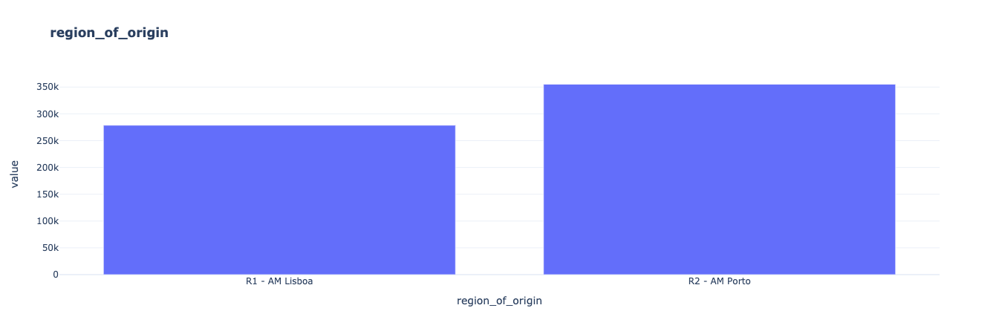

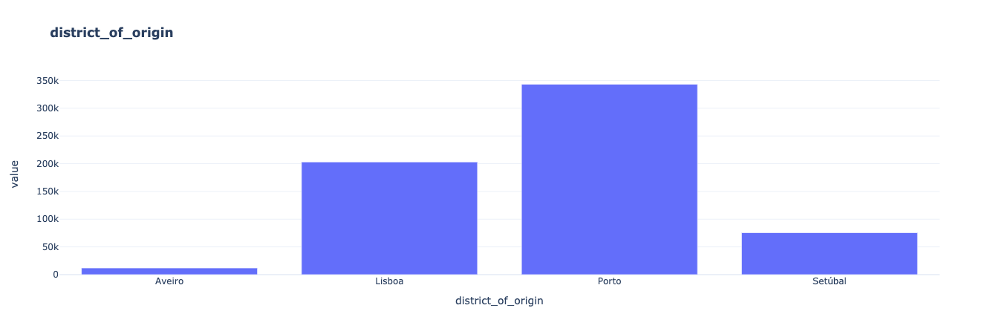

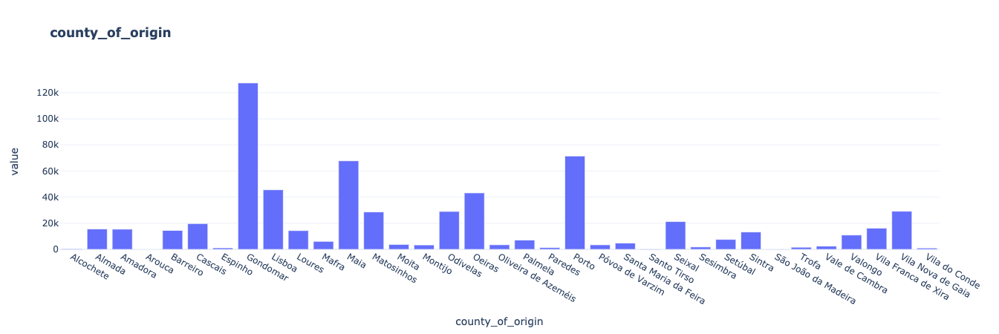

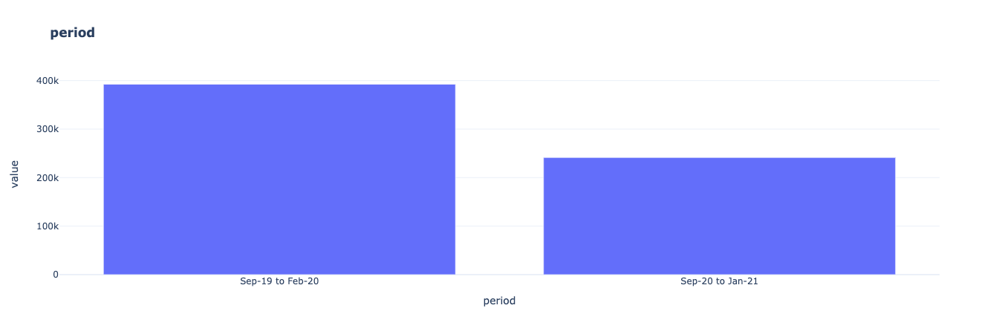

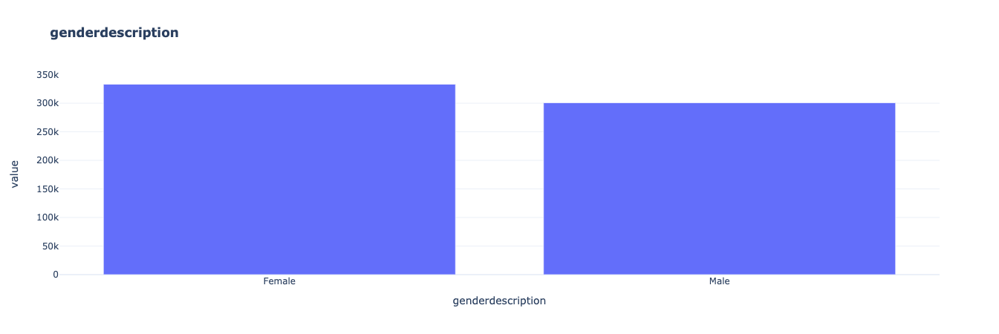

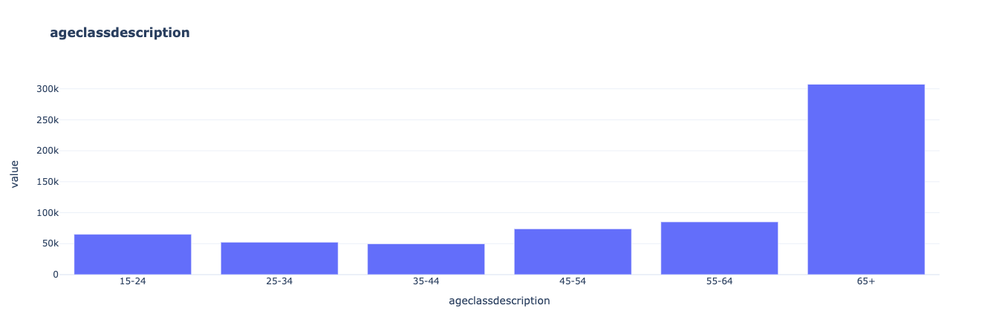

In [187]:
for col in df_up.select_dtypes(include='object').columns:
    fig = df_up.groupby(col).agg({
        'average_bususers_per_day': 'sum'
    }).plot.bar(template = 'plotly_white', title = '<b>' + col)
    fig.update_layout(showlegend = False).show()

# Datos demográficos

In [5]:
df_portugal = pd.read_csv(DATA_PATH / 'portugal_completo_procesado.csv')
df_portugal.head()

,county,genderdescription,ageclassdescription,population
0,Abrantes,Female,15-24,1594.0
1,Abrantes,Female,25-34,1459.0
2,Abrantes,Female,35-44,2134.0
3,Abrantes,Female,45-54,2574.0
4,Abrantes,Female,55-64,2765.0


Demographic Data Distribution

In [151]:
df_by_gender = df_up[['county_of_origin']].drop_duplicates().merge(
    df_portugal, 
    left_on=['county_of_origin'], 
    right_on=['county'],
    how='inner'
).groupby('genderdescription').agg({'population': 'sum'}).reset_index()
df_by_gender['pop_total'] = df_by_gender.population.sum()
df_by_gender['%_pop_gender'] = (df_by_gender['population']/ df_by_gender['pop_total']).round(4).mul(100)
df_by_gender

,genderdescription,population,pop_total,%_pop_gender
0,Female,2188751.0,3989765.0,54.86
1,Male,1801014.0,3989765.0,45.14


In [159]:
df_by_age= df_up[['county_of_origin']].drop_duplicates().merge(
    df_portugal, 
    left_on=['county_of_origin'], 
    right_on=['county'],
    how='inner'
).groupby('ageclassdescription').agg({'population': 'sum'}).reset_index()
df_by_age['pop_total'] = df_by_age.population.sum()
df_by_age['%_pop_gender'] = (df_by_age['population']/ df_by_age['pop_total']).round(4).mul(100)
df_by_age

,ageclassdescription,population,pop_total,%_pop_gender
0,15-24,477918.0,3989765.0,11.98
1,25-34,486931.0,3989765.0,12.20
2,35-44,662302.0,3989765.0,16.60
3,45-54,682152.0,3989765.0,17.10
4,55-64,606985.0,3989765.0,15.21
5,65+,1073477.0,3989765.0,26.91


In [32]:
1801014.0 / (1801014.0 + 2188751.0)

0.45140854160583394

#### Tables joining

In [38]:
df_portugal = pd.read_csv(PATH_DATA / 'portugal_completo_procesado.csv')

In [39]:
df = df_users_profile.merge(
    df_portugal, 
    how='left', 
    left_on=['county_of_origin', 'genderdescription', 'ageclassdescription'],
    right_on=['county', 'genderdescription', 'ageclassdescription']
)
df.head()

,region_of_origin,district_of_origin,county_of_origin,period,genderdescription,ageclassdescription,average_bususers_per_day,county,population
0,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,Amadora,8782.0
1,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,25-34,1081.652817,Amadora,11062.0
2,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,35-44,235.836653,Amadora,13943.0
3,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,45-54,840.951323,Amadora,12806.0
4,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,55-64,1216.148092,Amadora,12553.0


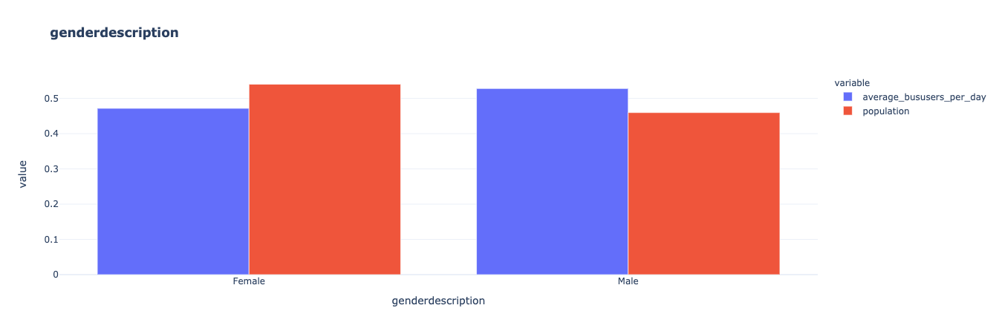

<hr>

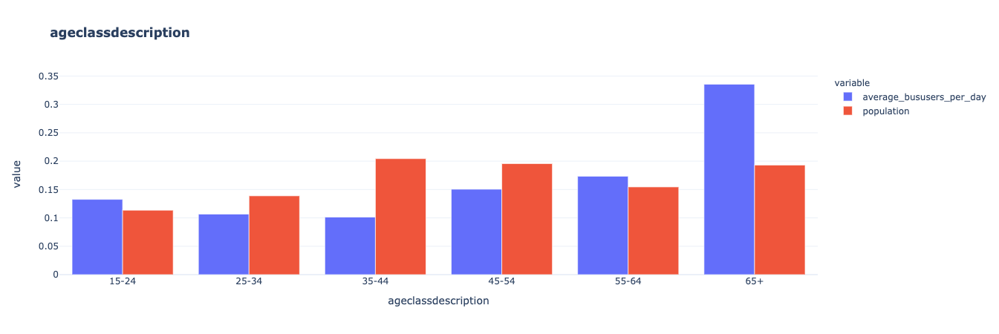

<hr>

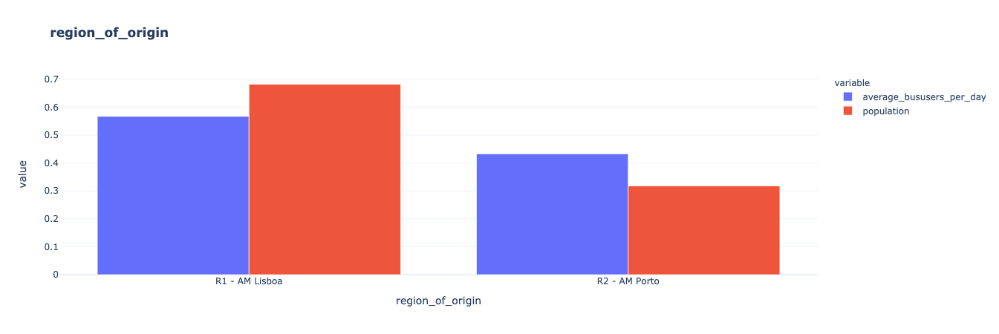

<hr>

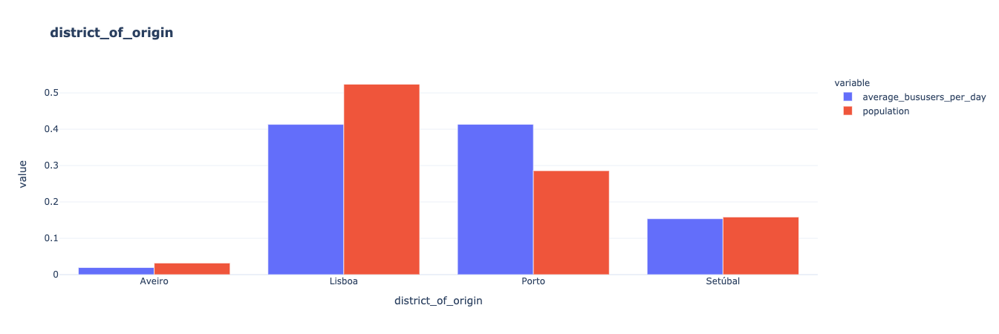

<hr>

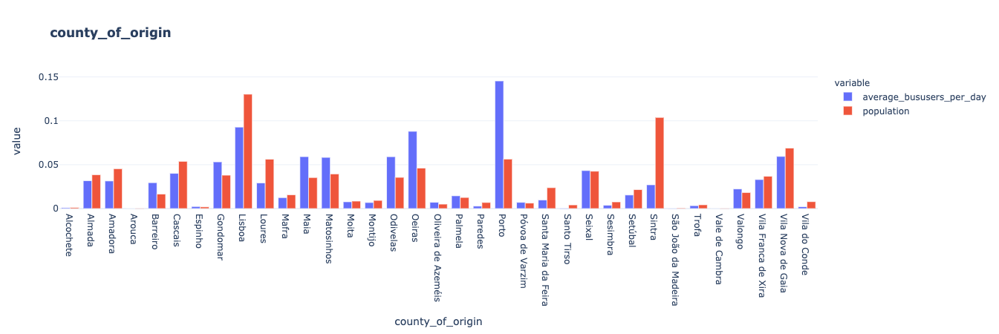

<hr>

In [133]:
for col in ['genderdescription', 'ageclassdescription', 'region_of_origin', 
            'district_of_origin', 'county_of_origin']:
    df_temp = df.loc[df['average_bususers_per_day'] <= df['population']]
    usuarios = df_temp.groupby(col).agg({
        'average_bususers_per_day': 'sum'
    }).div(df_temp['average_bususers_per_day'].sum())
    habitantes = df_temp.groupby(col).agg({
        'population': 'sum'
    }).div(df_temp['population'].sum())
    total = usuarios.merge(habitantes, left_index=True, right_index=True)
    fig = total.plot.bar(barmode='group', template = 'plotly_white', title = '<b>' + col)
    fig.show()
    display(Markdown('<hr>'))

### Outlier detection

#### Order by average_bususers_per_day

In [41]:
df.nlargest(10, 'average_bususers_per_day')

,region_of_origin,district_of_origin,county_of_origin,period,genderdescription,ageclassdescription,average_bususers_per_day,county,population
184,R2 - AM Porto,Porto,Gondomar,Sep-19 to Feb-20,Female,65+,66882.208463,Gondomar,17299.0
201,R2 - AM Porto,Porto,Maia,Sep-19 to Feb-20,Male,65+,38731.005027,Maia,10831.0
456,R2 - AM Porto,Porto,Gondomar,Sep-20 to Jan-21,Female,65+,34406.417961,Gondomar,17299.0
224,R2 - AM Porto,Porto,Porto,Sep-19 to Feb-20,Male,65+,13509.241837,Porto,23469.0
218,R2 - AM Porto,Porto,Porto,Sep-19 to Feb-20,Female,65+,11774.918453,Porto,31687.0
75,R1 - AM Lisboa,Lisboa,Oeiras,Sep-19 to Feb-20,Male,65+,9574.868536,Oeiras,17966.0
474,R2 - AM Porto,Porto,Maia,Sep-20 to Jan-21,Male,65+,8596.305685,Maia,10831.0
190,R2 - AM Porto,Porto,Gondomar,Sep-19 to Feb-20,Male,65+,7947.050672,Gondomar,14387.0
496,R2 - AM Porto,Porto,Porto,Sep-20 to Jan-21,Female,65+,7867.453847,Porto,31687.0
501,R2 - AM Porto,Porto,Porto,Sep-20 to Jan-21,Male,65+,6940.273923,Porto,23469.0


#### Which raws have more bus users than inhabitants?

In [42]:
df.loc[df['average_bususers_per_day'] >= df['population']]

,region_of_origin,district_of_origin,county_of_origin,period,genderdescription,ageclassdescription,average_bususers_per_day,county,population
184,R2 - AM Porto,Porto,Gondomar,Sep-19 to Feb-20,Female,65+,66882.208463,Gondomar,17299.0
201,R2 - AM Porto,Porto,Maia,Sep-19 to Feb-20,Male,65+,38731.005027,Maia,10831.0
450,R2 - AM Porto,Aveiro,Vale de Cambra,Sep-20 to Jan-21,Male,65+,2458.667434,Vale de Cambra,2364.0
456,R2 - AM Porto,Porto,Gondomar,Sep-20 to Jan-21,Female,65+,34406.417961,Gondomar,17299.0


### Visualization

#### Cities

In [173]:
gdf_mean_average_bususers_per_day_by_dicofre = (
    gdf_churn_users_profile_joined
    .groupby(
        ['region_of_origin', 'dicofre_parishcode_of_public_transportation', 'region_of_public_transportation'],
        as_index=False)
    .agg(geometry=('geometry', 'first'),
         mean_average_bususers_per_day=('average_bususers_per_day', 'mean'))
)

gdf_mean_average_bususers_per_day_by_dicofre.crs = CRS

scale_color_min = (
    gdf_mean_average_bususers_per_day_by_dicofre
    ['mean_average_bususers_per_day']
    .min()
)

scale_color_max = (
    gdf_mean_average_bususers_per_day_by_dicofre
    ['mean_average_bususers_per_day']
    .max()
)

scale_color_palette = linear.YlGnBu_09.scale(scale_color_min, scale_color_max)

mask_lisbon = (
    gdf_mean_average_bususers_per_day_by_dicofre['region_of_public_transportation']
    == 'R1 - AM Lisboa'
)

gdf_mean_average_bususers_per_day_by_dicofre_lisbon = (
    gdf_mean_average_bususers_per_day_by_dicofre[mask_lisbon]
)

show_parishes_map(gdf=gdf_mean_average_bususers_per_day_by_dicofre_lisbon,
                  city='lisbon',
                  scale_color_palette=scale_color_palette,
                  color_metric='mean_average_bususers_per_day',
                  fields=['region_of_origin'],
                  aliases=['Origin'],
                  zoom_start=10,
                  tiles='cartodbpositron')

**Porto Visualization**

In [172]:
mask_porto = (
    gdf_mean_average_bususers_per_day_by_dicofre['region_of_public_transportation']
    == 'R2 - AM Porto'
)

gdf_mean_average_bususers_per_day_by_dicofre_porto = (
    gdf_mean_average_bususers_per_day_by_dicofre[mask_porto]
)

show_parishes_map(gdf=gdf_mean_average_bususers_per_day_by_dicofre_porto,
                  city='porto',
                  scale_color_palette=scale_color_palette,
                  color_metric='mean_average_bususers_per_day',
                  fields=['region_of_origin'],
                  aliases=['Origin'],
                  zoom_start=10,
                  tiles='cartodbpositron')

#### All Counties

In [165]:
gdf_city = gpd.GeoDataFrame(
    df_city, geometry=gpd.points_from_xy(df_city.lng, df_city.lat))

In [170]:
plot_map_elements(gdf_city, feature_search = 'city', features = ['city'], features_alias = ['city'], location_map = [40, -9], zoom_start_map = 7)

#### Bus Stations and Bus Stops

In [171]:
plot_map_elements(df_bus, feature_search = 'name', features = ['name'], features_alias = ['name'], location_map = [40, -9], zoom_start_map = 7)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.




### Churn Analysis

#### Analysis Pre-COVID vs Post-COVID

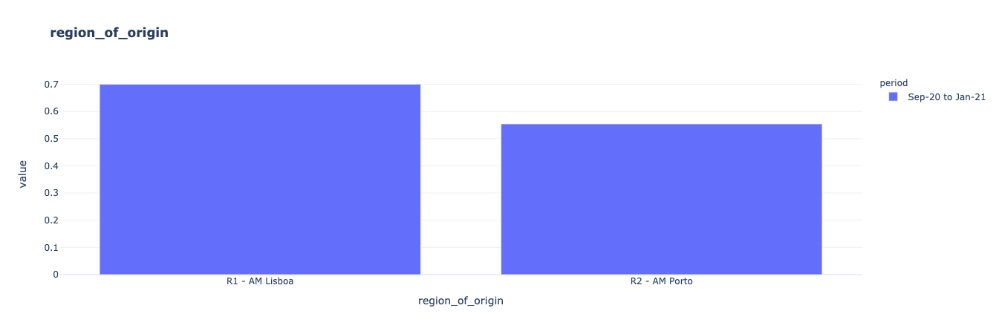

<hr>

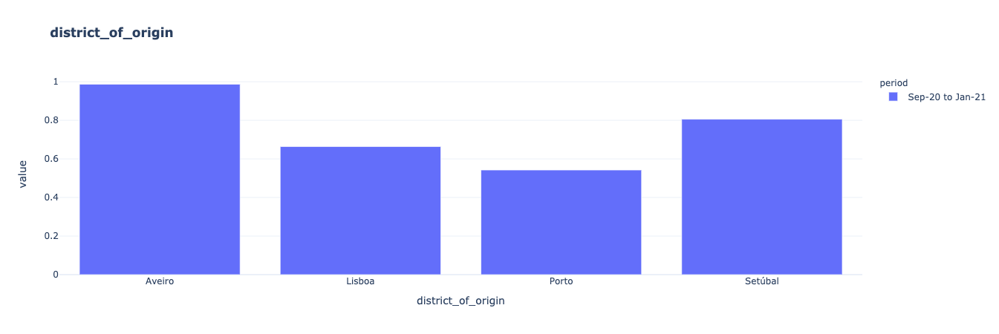

<hr>

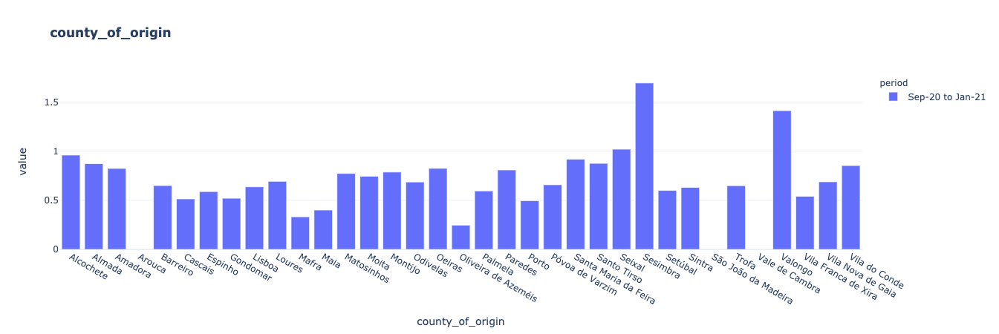

<hr>

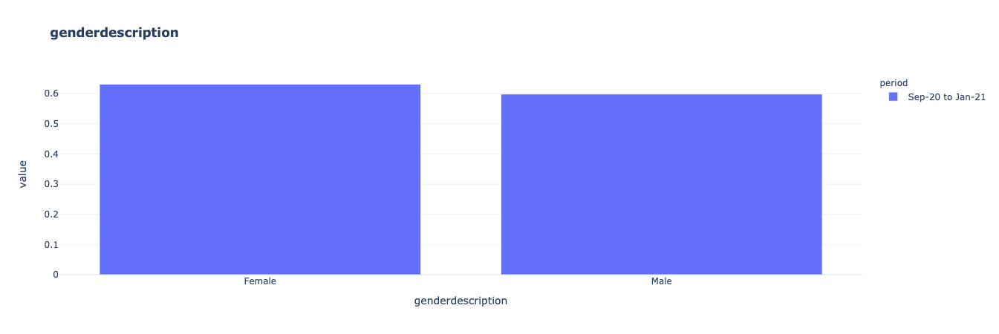

<hr>

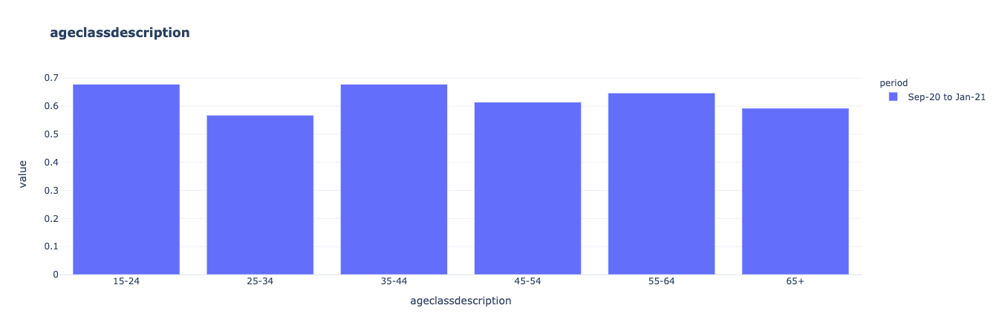

<hr>

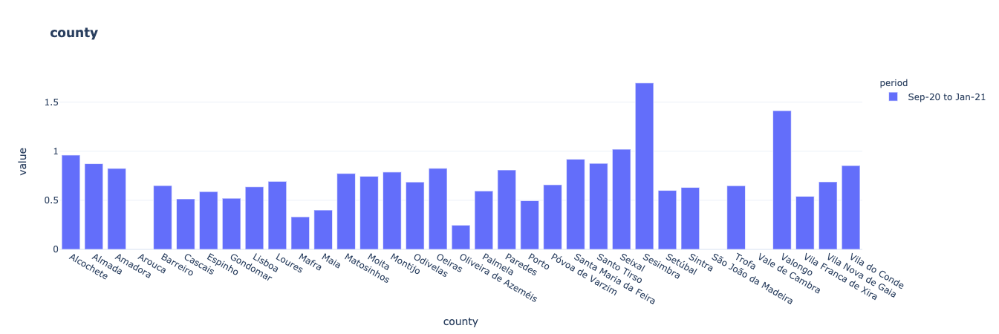

<hr>

In [179]:
for col in df.drop(columns=['period', 'average_bususers_per_day', 'population']):
    fig = (
        df
        .groupby(['period', col])
        .agg({'average_bususers_per_day': 'sum'})
        .reset_index()
        .pivot(index=col, columns='period', values='average_bususers_per_day')
        .pct_change(axis=1)
        .add(1)
        .dropna(axis=1, how='all')
        .plot.bar( template = 'plotly_white', title = '<b>' + col)
    )
    fig.show()
    display(Markdown('<hr>'))

In [112]:
(df.groupby('period').agg({'average_bususers_per_day': 'sum'})
 .pct_change())

,average_bususers_per_day
period,
Sep-19 to Feb-20,NaN
Sep-20 to Jan-21,-0.384849


### Modeling

#### Master Table Creation

In [51]:
DATA_PATH = Path('../data')
list(DATA_PATH.glob('*'))

[PosixPath('../data/google_trends.csv'),
 PosixPath('../data/master_table.csv'),
 PosixPath('../data/airports.csv'),
 PosixPath('../data/google_mobility.csv'),
 PosixPath('../data/df_covid.csv'),
 PosixPath('../data/portugal_completo_procesado.csv'),
 PosixPath('../data/portugal_completo_raw.csv'),
 PosixPath('../data/pollution_data.csv'),
 PosixPath('../data/df_city.csv'),
 PosixPath('../data/.ipynb_checkpoints'),
 PosixPath('../data/portugal_basico_procesado.csv'),
 PosixPath('../data/df_bus.csv'),
 PosixPath('../data/parishes'),
 PosixPath('../data/distancias.csv'),
 PosixPath('../data/df_bus_county.csv'),
 PosixPath('../data/portugal_completo_clean.csv')]

#### Users profile

In [52]:
df_up = pd.read_csv(
    'https://wdl-data.fra1.digitaloceanspaces.com/pse/Churn_UsersProfile.txt', sep='|', encoding='cp1252'
).rename(columns=lambda x: x.lower())
print(df_up.shape)
df_up.head()

(544, 7)


,region_of_origin,district_of_origin,county_of_origin,period,genderdescription,ageclassdescription,average_bususers_per_day
0,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206
1,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,25-34,1081.652817
2,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,35-44,235.836653
3,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,45-54,840.951323
4,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,55-64,1216.148092


# Origin - Destination

In [53]:
df_od = pd.read_csv(
    'https://wdl-data.fra1.digitaloceanspaces.com/pse/Churn_OD.txt', sep='|', encoding='cp1252'
).rename(columns=lambda x: x.lower()) # .drop(columns = ["dicofre_parishcode_of_public_transportation"])

df_od['district_of_public_transportation'] = df_od['district_of_public_transportation'].apply(
    lambda x: ' '.join([x.capitalize() if x not in ['DE', 'DA', 'DO'] else x.lower() for x in x.split(' ')])
)# .str.title()
df_od['county_of_public_transportation'] = df_od['county_of_public_transportation'].apply(
    lambda x: ' '.join([x.capitalize() if x not in ['DE', 'DA', 'DO'] else x.lower() for x in x.split(' ')])
)
print(df_od.shape)
df_od.head()

(2253, 8)


,region_of_origin,district_of_origin,county_of_origin,region_of_public_transportation,district_of_public_transportation,county_of_public_transportation,dicofre_parishcode_of_public_transportation,demand_weight
0,R1 - AM Lisboa,Lisboa,Amadora,R1 - AM Lisboa,Lisboa,Lisboa,110608,0.307323
1,R1 - AM Lisboa,Lisboa,Amadora,R1 - AM Lisboa,Lisboa,Lisboa,110639,0.069997
2,R1 - AM Lisboa,Lisboa,Amadora,R1 - AM Lisboa,Lisboa,Lisboa,110658,0.066059
3,R1 - AM Lisboa,Lisboa,Amadora,R1 - AM Lisboa,Lisboa,Lisboa,110654,0.059847
4,R1 - AM Lisboa,Lisboa,Amadora,R1 - AM Lisboa,Lisboa,Lisboa,110633,0.052341


In [54]:
df_od.groupby('county_of_public_transportation').agg({'demand_weight': 'sum'})

,demand_weight
county_of_public_transportation,
Almada,0.024583
Amadora,0.187711
Gondomar,0.436409
Lisboa,21.375585
Loures,0.103482
Maia,0.557156
Matosinhos,2.468122
Odivelas,0.034809
Oeiras,0.355440


# UP - OD

In [55]:
df_up_od = df_up.merge(
    df_od, how='left'
)
print(df_up_od.shape)
# Esto solo es válido si suponemos los mismos pesos en las routas para todos los segmentos demográficos
df_up_od['average_bususers_per_day_route'] = (
    df_up_od['average_bususers_per_day'] * df_up_od['demand_weight']
)
df_up_od.head()

(40422, 12)


,region_of_origin,district_of_origin,county_of_origin,period,genderdescription,ageclassdescription,average_bususers_per_day,region_of_public_transportation,district_of_public_transportation,county_of_public_transportation,dicofre_parishcode_of_public_transportation,demand_weight,average_bususers_per_day_route
0,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,R1 - AM Lisboa,Lisboa,Lisboa,110608.0,0.307323,90.412646
1,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,R1 - AM Lisboa,Lisboa,Lisboa,110639.0,0.069997,20.592712
2,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,R1 - AM Lisboa,Lisboa,Lisboa,110658.0,0.066059,19.434175
3,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,R1 - AM Lisboa,Lisboa,Lisboa,110654.0,0.059847,17.606641
4,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,R1 - AM Lisboa,Lisboa,Lisboa,110633.0,0.052341,15.398419


In [56]:
df_routes_weight = (
    df_od
    .groupby(['county_of_origin', 'county_of_public_transportation'], as_index=False)
    .demand_weight
    .sum()
)

df_up_routes_weight_merged = (df_up
 .merge(df_routes_weight,
        on='county_of_origin'))

df_up_routes_weight_merged['average_bususers_per_day_route'] = (
    df_up_routes_weight_merged['average_bususers_per_day'] * df_up_routes_weight_merged['demand_weight']
)

### Demographic Information

In [57]:
population = pd.read_csv(DATA_PATH / 'portugal_completo_procesado.csv').rename(columns={
    'county': 'county_of_origin'
})
print(population.shape)
population.head()

(4032, 4)


,county_of_origin,genderdescription,ageclassdescription,population
0,Abrantes,Female,15-24,1594.0
1,Abrantes,Female,25-34,1459.0
2,Abrantes,Female,35-44,2134.0
3,Abrantes,Female,45-54,2574.0
4,Abrantes,Female,55-64,2765.0


In [58]:
population

,county_of_origin,genderdescription,ageclassdescription,population
0,Abrantes,Female,15-24,1594.0
1,Abrantes,Female,25-34,1459.0
2,Abrantes,Female,35-44,2134.0
3,Abrantes,Female,45-54,2574.0
4,Abrantes,Female,55-64,2765.0
...,...,...,...,...
4027,Óbidos,Male,25-34,612.0
4028,Óbidos,Male,35-44,748.0
4029,Óbidos,Male,45-54,822.0
4030,Óbidos,Male,55-64,787.0


In [59]:
df_up_od_population = df_up_routes_weight_merged.merge(population, how='left')
df_up_od_population.shape

(7823, 11)

#### Distance between cities

In [60]:
distancias = pd.read_csv(DATA_PATH / 'distancias.csv').rename(columns={'value': 'distance'})
print(distancias.shape)
distancias.head()

(1225, 3)


,origin,variable,distance
0,Amadora,Amadora,0.00
1,Cascais,Amadora,19.69
2,Lisboa,Amadora,11.23
3,Loures,Amadora,12.04
4,Mafra,Amadora,22.68


In [61]:
df_population_distance = df_up_od_population.merge(
    distancias, how='left', 
    left_on=['county_of_origin', 'county_of_public_transportation'],
    right_on=['origin', 'variable']
).drop(columns=['origin', 'variable'])
df_population_distance.shape

(7823, 12)

### Merge by Position(Lat and Long)

#### Pollution

In [62]:
pollution = pd.read_csv(DATA_PATH / 'pollution_data.csv')
pollution['date'] = pd.to_datetime(pollution['date'])
print(pollution.shape)
pollution.head()

(56245, 11)


,date,co,no,no2,o3,so2,pm2_5,pm10,nh3,aqi,county
0,2020-11-25 02:00:00,200.27,0.0,4.07,80.11,2.09,4.67,5.31,0.09,2,Amadora
1,2020-11-25 03:00:00,198.60,0.0,3.56,80.11,1.76,3.72,4.27,0.10,2,Amadora
2,2020-11-25 04:00:00,200.27,0.0,3.34,79.39,1.61,2.38,2.90,0.13,1,Amadora
3,2020-11-25 05:00:00,200.27,0.0,3.43,77.96,1.62,1.78,2.27,0.16,1,Amadora
4,2020-11-25 06:00:00,201.94,0.0,3.77,72.24,1.79,1.81,2.33,0.18,1,Amadora


In [136]:
from sklearn.preprocessing import StandardScaler

pollution = pollution.loc[pollution['date'].dt.hour.between(7, 20)]

scaler = StandardScaler()
pollution_scaled = pollution.drop(columns = ["date", "aqi", "county"])
pollution_scaled = scaler.fit_transform(pollution_scaled)
pollution_scaled_df = pd.DataFrame(pollution_scaled, columns = pollution.select_dtypes("float").columns)
display(pollution_scaled_df.shape)
pollution_scaled_df = pd.concat(
    [pollution[["date", "county"]].reset_index(drop = True), pollution_scaled_df], axis = 1
)
pollution_scaled_df["timestamp_mean"] = pollution_scaled_df.drop(columns = ["date", "county"]).mean(axis = 1)
#pollution_grouped = pollution_scaled_df.groupby("county").agg({"timestamp_mean": ["median", "max"]})
pollution_grouped = pollution_scaled_df.groupby("county").agg(
    median_pollution = ("timestamp_mean", "median"), 
    max_pollution = ("timestamp_mean", "max")
)
#pollution_grouped.columns = pollution_grouped.columns.droplevel()
pollution_grouped = pollution_grouped.reset_index()
pollution_grouped.sort_values(by = ["median_pollution"], ascending = False).sample(3)

(32830, 8)

,county,median_pollution,max_pollution
11,Maia,-0.032564,6.266074
33,Vila Nova de Gaia,-0.032564,6.266074
25,Sesimbra,-0.222539,1.633041


In [64]:
df_population_distance_pollution = df_population_distance.merge(
    pollution_grouped, how = "left", left_on = "county_of_origin", right_on = "county"
).merge(
    pollution_grouped, how = "left", left_on = "county_of_public_transportation", right_on = "county", suffixes = ("_origin", "_destination")
).drop(columns = ["county_origin", "county_destination"])

df_population_distance_pollution.head()

,region_of_origin,district_of_origin,county_of_origin,period,genderdescription,ageclassdescription,average_bususers_per_day,county_of_public_transportation,demand_weight,average_bususers_per_day_route,population,distance,median_pollution_origin,max_pollution_origin,median_pollution_destination,max_pollution_destination
0,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,Almada,0.000282,0.082963,8782.0,11.21,-0.074655,8.266864,-0.086260,4.622488
1,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,Amadora,0.059090,17.383936,8782.0,0.00,-0.074655,8.266864,-0.074655,8.266864
2,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,Gondomar,0.000005,0.001471,8782.0,272.56,-0.074655,8.266864,-0.032564,6.266074
3,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,Lisboa,0.913746,268.818779,8782.0,11.23,-0.074655,8.266864,-0.074655,8.266864
4,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,Loures,0.001792,0.527196,8782.0,12.04,-0.074655,8.266864,-0.074655,8.266864


In [65]:
(df_population_distance_pollution
             .drop(columns = ["average_bususers_per_day_route", "period", 'demand_weight', 'average_bususers_per_day'])
             .columns.to_list())

['region_of_origin',
 'district_of_origin',
 'county_of_origin',
 'genderdescription',
 'ageclassdescription',
 'county_of_public_transportation',
 'population',
 'distance',
 'median_pollution_origin',
 'max_pollution_origin',
 'median_pollution_destination',
 'max_pollution_destination']

In [66]:
df_population_distance_pollution

,region_of_origin,district_of_origin,county_of_origin,period,genderdescription,ageclassdescription,average_bususers_per_day,county_of_public_transportation,demand_weight,average_bususers_per_day_route,population,distance,median_pollution_origin,max_pollution_origin,median_pollution_destination,max_pollution_destination
0,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,Almada,0.000282,0.082963,8782.0,11.21,-0.074655,8.266864,-0.086260,4.622488
1,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,Amadora,0.059090,17.383936,8782.0,0.00,-0.074655,8.266864,-0.074655,8.266864
2,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,Gondomar,0.000005,0.001471,8782.0,272.56,-0.074655,8.266864,-0.032564,6.266074
3,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,Lisboa,0.913746,268.818779,8782.0,11.23,-0.074655,8.266864,-0.074655,8.266864
4,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206,Loures,0.001792,0.527196,8782.0,12.04,-0.074655,8.266864,-0.074655,8.266864
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7818,R2 - AM Porto,Aveiro,Vale de Cambra,Sep-20 to Jan-21,Male,65+,2458.667434,Gondomar,0.017432,42.859491,2364.0,35.43,-0.305390,1.989528,-0.032564,6.266074
7819,R2 - AM Porto,Aveiro,Vale de Cambra,Sep-20 to Jan-21,Male,65+,2458.667434,Lisboa,0.692551,1702.752590,2364.0,249.47,-0.305390,1.989528,-0.074655,8.266864
7820,R2 - AM Porto,Aveiro,Vale de Cambra,Sep-20 to Jan-21,Male,65+,2458.667434,Maia,0.000099,0.243408,2364.0,50.05,-0.305390,1.989528,-0.032564,6.266074
7821,R2 - AM Porto,Aveiro,Vale de Cambra,Sep-20 to Jan-21,Male,65+,2458.667434,Matosinhos,0.009955,24.476034,2364.0,48.49,-0.305390,1.989528,-0.032564,6.266074


In [68]:
prueba = df_population_distance_pollution.loc[df_population_distance_pollution['period'] == 'Sep-19 to Feb-20',
                                     ['county_of_origin', 'average_bususers_per_day', 'demand_weight', 'population']]
prueba['bususers_per_population'] = prueba['average_bususers_per_day'] / prueba['population']
prueba['average_bususers_per_day_route'] = prueba['average_bususers_per_day'] * prueba['demand_weight']
prueba.drop(columns=['population'])

,county_of_origin,average_bususers_per_day,demand_weight,bususers_per_population,average_bususers_per_day_route
0,Amadora,294.194206,0.000282,0.033500,0.082963
1,Amadora,294.194206,0.059090,0.033500,17.383936
2,Amadora,294.194206,0.000005,0.033500,0.001471
3,Amadora,294.194206,0.913746,0.033500,268.818779
4,Amadora,294.194206,0.001792,0.033500,0.527196
...,...,...,...,...,...
7597,Vila Nova de Gaia,21.943108,0.000000,0.001107,0.000000
7598,Vila Nova de Gaia,21.943108,0.000004,0.001107,0.000088
7599,Vila Nova de Gaia,21.943108,0.001704,0.001107,0.037391
7600,Vila Nova de Gaia,21.943108,0.478548,0.001107,10.500830


**Tiene sentido hacer 3 tipos de churn**

In [69]:
master_table_route_level.churn_rate.value_counts(bins=3)

(-0.001964, 0.321]    1446
(0.321, 0.643]        1192
(0.643, 0.964]         486
Name: churn_rate, dtype: int64

In [70]:
master_table_route_level

,region_of_origin,district_of_origin,county_of_origin,genderdescription,ageclassdescription,county_of_public_transportation,population,distance,median_pollution_origin,max_pollution_origin,median_pollution_destination,max_pollution_destination,churn_rate
1,R1 - AM Lisboa,Lisboa,Amadora,Female,15-24,Almada,8782.0,11.21,-0.074655,8.266864,-0.086260,4.622488,0.000000
3,R1 - AM Lisboa,Lisboa,Amadora,Female,15-24,Amadora,8782.0,0.00,-0.074655,8.266864,-0.074655,8.266864,0.000000
5,R1 - AM Lisboa,Lisboa,Amadora,Female,15-24,Gondomar,8782.0,272.56,-0.074655,8.266864,-0.032564,6.266074,0.000000
7,R1 - AM Lisboa,Lisboa,Amadora,Female,15-24,Lisboa,8782.0,11.23,-0.074655,8.266864,-0.074655,8.266864,0.000000
9,R1 - AM Lisboa,Lisboa,Amadora,Female,15-24,Loures,8782.0,12.04,-0.074655,8.266864,-0.074655,8.266864,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...
7749,R2 - AM Porto,Porto,Vila do Conde,Female,35-44,Porto,6245.0,27.52,-0.228206,2.279884,-0.032564,6.266074,0.932451
7751,R2 - AM Porto,Porto,Vila do Conde,Female,35-44,Santo Tirso,6245.0,30.10,-0.228206,2.279884,-0.228098,1.586126,0.932451
7753,R2 - AM Porto,Porto,Vila do Conde,Female,35-44,Valongo,6245.0,33.28,-0.228206,2.279884,-0.216393,2.074101,0.932451
7755,R2 - AM Porto,Porto,Vila do Conde,Female,35-44,Vila Nova de Gaia,6245.0,29.61,-0.228206,2.279884,-0.032564,6.266074,0.932451


In [71]:
df_google_mobility = (
    pd
    .read_csv(DATA_PATH / 'google_mobility.csv')
    .drop(columns=['Unnamed: 0', 'sub_region_1', 'census_fips_code'])
    .rename(columns=dict(sub_region_2='county'))
)

In [72]:
df_bus_county = (
    pd
    .read_csv(DATA_PATH / 'df_bus_county.csv',
              usecols=['county', 'bus_station_by_1k', 'bus_stop_by_1k'])
)

(master_table_route_level
 .merge(
     df_bus_county
     .rename(columns={column: f'{column}_origin' if column != 'county' else f'{column}_of_origin'
                      for column in df_bus_county.columns})
 )
 .merge(
     df_bus_county
     .rename(columns={column: f'{column}_destiny' if column != 'county' else f'{column}_of_origin'
                      for column in df_bus_county.columns})
 )
 .merge(
     df_google_mobility
     .rename(columns={column: f'{column}_origin' if column != 'county' else f'{column}_of_origin'
                      for column in df_google_mobility.columns})
 )
 .merge(
     df_google_mobility
     .rename(columns={column: f'{column}_destiny' if column != 'county' else f'{column}_of_origin'
                      for column in df_google_mobility.columns})
 )
 .merge(
     prueba.drop(columns=['population'])
     .rename(columns={column: f'{column}_destiny' if column != 'county' else f'{column}_of_origin'
                      for column in df_google_mobility.columns})
 )
).to_csv(DATA_PATH / 'master_data_test.csv', index=None)

In [73]:
master_table.average_bususers_per_day_route.isnull().sum()

0

In [74]:
(master_table[master_table['county_of_origin']=='Almada']
 .groupby(['county_of_origin', 'genderdescription', 'ageclassdescription'])
 .average_bususers_per_day_route
 .agg(lambda x: set(x.round(2))))

county_of_origin  genderdescription  ageclassdescription
Almada            Female             15-24                   {1.39}
                                     25-34                  {-0.23}
                                     35-44                  {-0.57}
                                     45-54                  {-0.54}
                                     55-64                  {-0.56}
                  Male               15-24                  {-0.67}
                                     25-34                  {27.39}
                                     35-44                   {0.35}
                                     45-54                   {-0.2}
                                     55-64                  {-0.08}
                                     65+                     {1.52}
Name: average_bususers_per_day_route, dtype: object

In [75]:
master_table['average_bususers_per_day_route'].mul(-1).clip(0, 1).value_counts(bins=3)

(-0.001964, 0.321]    1446
(0.321, 0.643]        1192
(0.643, 0.964]         486
Name: average_bususers_per_day_route, dtype: int64

In [76]:
df_population_distance_pollution.shape

(7823, 16)

In [77]:
(df_population_distance_pollution
.groupby(df_population_distance_pollution
         .drop(columns = ["average_bususers_per_day_route", "period", 'demand_weight', 'average_bususers_per_day'])
         .columns.to_list())
.apply(lambda x: x['average_bususers_per_day_route'])
.reset_index().head())

,region_of_origin,district_of_origin,county_of_origin,genderdescription,ageclassdescription,county_of_public_transportation,population,distance,median_pollution_origin,max_pollution_origin,median_pollution_destination,max_pollution_destination,level_12,average_bususers_per_day_route
0,R1 - AM Lisboa,Lisboa,Amadora,Female,15-24,Almada,8782.0,11.21,-0.074655,8.266864,-0.086260,4.622488,0,0.082963
1,R1 - AM Lisboa,Lisboa,Amadora,Female,15-24,Almada,8782.0,11.21,-0.074655,8.266864,-0.086260,4.622488,176,0.151153
2,R1 - AM Lisboa,Lisboa,Amadora,Female,15-24,Amadora,8782.0,0.00,-0.074655,8.266864,-0.074655,8.266864,1,17.383936
3,R1 - AM Lisboa,Lisboa,Amadora,Female,15-24,Amadora,8782.0,0.00,-0.074655,8.266864,-0.074655,8.266864,177,31.672546
4,R1 - AM Lisboa,Lisboa,Amadora,Female,15-24,Gondomar,8782.0,272.56,-0.074655,8.266864,-0.032564,6.266074,2,0.001471


In [22]:
PATH_DATA = Path('../data')
NO_COLUMNS = ['county_of_origin', 'county_of_public_transportation']
FILLNA = 'UNKNOWN'
TARGET = 'churn_rate'

In [23]:
df_master_table = pd.read_csv(PATH_DATA / 'master_data_test.csv')

#### Model Development

In [24]:
PATH_DATA = Path('../data')
NO_COLUMNS = ['county_of_origin', 'county_of_public_transportation']
FILLNA = 'UNKNOWN'
TARGET = 'churn_rate'

#### Reading Data 

In [25]:
df_master_table = pd.read_csv(PATH_DATA / 'master_data_test.csv')

#### Building The Targets

In [26]:
X = df_master_table.drop(columns=[TARGET] + NO_COLUMNS)
y = df_master_table[TARGET]

y_low = (y < .15).astype(int)
y_medium = ((y > .15) & (y <= .60)).astype(int)
y_high = (y >= .60).astype(int)

dict_gender = dict(Female=0, Male=1)

X['ageclassdescription'] = X['ageclassdescription'].str.extract('(\d+)-').astype(float)
X['genderdescription'] = X['genderdescription'].map(dict_gender)

invalid escape sequence \d
invalid escape sequence \d
invalid escape sequence \d
invalid escape sequence \d


#### Machine Learning

In [27]:
cat_features = X.select_dtypes('object').columns.tolist()
num_features = X.select_dtypes('number').columns.tolist()

X[cat_features] = X[cat_features].fillna(FILLNA)

cb_params = dict(num_trees=50, max_depth=3, colsample_bylevel=.5, verbose=False)

pipeline_cb = make_pipeline(
    OneHotEncoder(use_cat_names=True),
    CatBoostRegressor(**cb_params)
)

pipeline_cb.fit(X, y);

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


### Model Interpretation 

In [28]:
X_to_explain = pipeline_cb.named_steps['onehotencoder'].transform(X)

explainer = shap.Explainer(pipeline_cb.named_steps['catboostregressor'])
shap_values = explainer(X_to_explain)

In [29]:
import sys
import shap
import pandas as pd

from pathlib import Path
from category_encoders import OneHotEncoder
from sklearn import set_config
from sklearn.pipeline import make_pipeline
from sklearn.compose import make_column_transformer
from sklearn.impute import SimpleImputer
from catboost import CatBoostRegressor, CatBoostClassifier

sys.path.append('../scripts')

from helpers import create_shap_top_importance_columns

set_config(display='diagram')   

# Feature Importances 

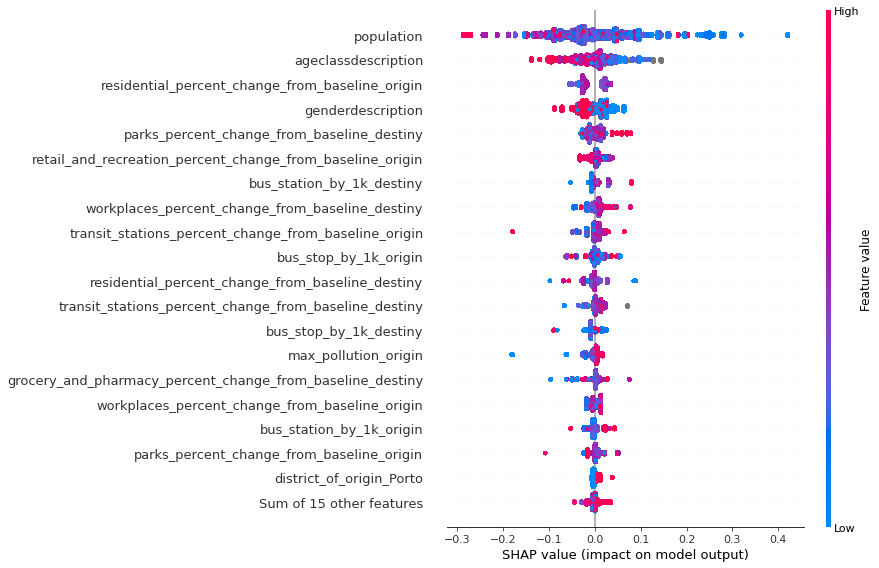

In [30]:
shap.plots.beeswarm(shap_values, max_display=20)

## Gender And Age Features Interaction 

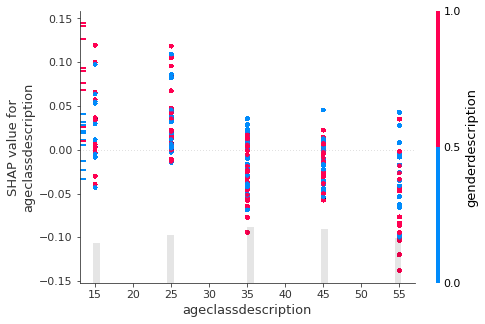

In [31]:
shap.plots.scatter(shap_values[:, 'ageclassdescription'], color=shap_values[:, 'genderdescription'])

#### Model Interpreation 

## Conclusions

> Tell us how applicable and scalable your solution is if you were to implement it in a city. Identify possible limitations and measure the potential social impact of your solution.

### Identify Churn Profiles

Checking our analysis:

+ Gender: We can detect that women are the main segment who leave the public transport during the pandemic

+ Age: As we can see in the shap values and in the descriptive analysis, young people, are the target. Besides, they are less vulnerable to Coronavirus 

+ Place Variable The churn varies a lot between the county/city, but there is an important city 'Porto' which will be our target, due to the churn level is close to 50%

### Take actions to reduce the churn

+ For Churn Type 1: We will focus our strategy on tourist (specially in airports, because they don't have here their own vehicles). Besides, it is important to win back costumers when they have to go to the office again.

+ For Churn Type 2: Now, we want to adapt our routes to the Coronavirus mobility trends. Now, people prefer going to park and open spaces, so we should redesign our routes and stations in order to cover the new demand.

+ For Churn Type 3: For this part, we analysed the profiles, and we are going to launch campaign to recapture users which will travel again after the pandemics. Young people (18-25), women and Porto are the special target for this marketing actions and discounts.

### Check the impact

We are going to divide this section into two big parts:

Before the actions (Predict the impact):

+ Use the model: Now, we have a prediction models with multiple varibles, so we can estimate our impact. For instance
    - Changing Google Trends values to 1 allow us to simulate a after Covid situation
    - Modifying number of stops for every 1k people can emulate the impact of selecting best places to locate bus stations/bus stops
+ Action Estimations:
    - We can make assumptions to evaluate the impact. We can use past data to emulate what was the effect in the past. For instance: if you reduce the ticket price for         one specific segments, it is not hard to get a function to relate this price with the demand

During/After the actions (Evaluate the real impact):

+ Checking Internal Data: We can evaluate the future dataset to do a new analysis to evaluate how was the impact of all the measures. The analysis would be similar to our analysis comparing pre covid data and post covid data.

+ Checking External Data: It would be nice if we can compare the effect of the churn reduction in the external data sources. We can evaluate the traffic and pollution (direct actions) or we can evaluate long-term effects such as new car purchase en Portugal

+ Experiments and Surveys: If we are going to a big change in the public transport, it would be good if we develop a experiment before. Now, actual conditions are weird so it is important to try to evaluate the impact in real conditions before taking important actions. Depending on the type of action, it could be a simply A/B test, or it can include some complex techniques such as switchback if cannibalization effects could have an impact

### Scalability
When we started to solve this problem, we try to look for a global solution which can be adapted for different city/countries. Public transport has the same goals, and bus is one of the most popular vehicles for public transport, but we will explain multiple points one by one

+ Business Understanding Context: Our business approach for solving the problem is similar for all places. Churn classification can have slight differences, but the the general method can be used if we want to implement our solution in other city. A bit of research can be good for understanding the new place circumstances. 

+ Sources of Data: In terms of external data, The data that we used is very scalable. Open Street Maps, Google Trends and Weather data are also available for more cities (the accuracy can vary a bit depending of multiple factors). The only data that is specific for Portugal is the demographic data, but most of places share this kind of information in a similar format. On the other hand, the internal data with information about public transportation should be given by the public entity since it is not easy to get.

+ Algorithms: All algorithms and models used during this post can be utilised for other contexts and they are not specific. Small changes can be applied to the feature engineering or parameter tuning, but only small changes are required


### Future Work
> Now picture the following scenario: imagine you could have access to any type of data that could help you solve this challenge even better. What would that data be and how would it improve your solution? 🚀

+ Use more and better data: The external and internal data can be improved. The best solution would be to get more data granularity in terms of dates and people segmentation. The more granularity we have, the more specific will be our analysis. Besides, we can include more external sources as airport information to include more variables in our analyses

+ Try more algorithms: For this model, we are using Catboost, that performs really well in a lot of scenarios. For this case, the sample is not extremely big, so another algorithms can be used in order to have a more solid model to interpret our variables. RandomForest or Logistic Regression are good options to try. We can also try simpler algorithms like correlation analysis.

+ Evaluate the impact with Prescriptive Analytics: Due to time limitations, it was hard to develop a Prescriptive Science analysis here. As next step, it would be ideal if we can develop an optimisation problem using our Machine Learning model and changing the inputs, to evaluate which variables can make a bigger impact in the output. In fact, we can estimate the costs and benefits, and have more specific actions

+ Develop experiments: In this moment of uncertainty, it is to hard to predict the impact of actions. We can to estimations by developing analysis and modeling, but it is not possible to know the real impact. For this reason, we can design experiments (simple or complex) to evaluate the actions taken and optimese the model outputs

## Appendixes

Here some functions that are neccesary for run the script

In [141]:
def helper(group):
    group_sorted = group.sort_values(by='period')
    return group_sorted['average_bususers_per_day_route'].pct_change()


master_table = (
    df_population_distance_pollution
    .groupby(df_population_distance_pollution
             .drop(columns = ["average_bususers_per_day_route", "period", 'demand_weight', 'average_bususers_per_day'])
             .columns.to_list())
    .apply(helper)
    .reset_index()
    .drop(columns=['level_12'])
    .dropna()
)

master_table_route_level = master_table.rename(columns=dict(average_bususers_per_day_route='churn_rate'))
master_table_route_level['churn_rate'] = master_table_route_level['churn_rate'].mul(-1).clip(0, 1)



def show_parishes_map(gdf: gpd.GeoDataFrame,
                      city: str,
                      scale_color_palette: LinearColormap,
                      color_metric: str,
                      fields: List[str],
                      aliases: List[str],
                      **args) -> folium.Map:
    """Show map of the stations for a given city
    with its own color scale
    """
    map_city = folium.Map(CITY_CENTERS[city], **args)

    folium.GeoJson(
        gdf,
        style_function = lambda x: {
            'fillColor': scale_color_palette(x['properties'][color_metric]),
            'color': 'black',
            'weight': 1.5,
            'fillOpacity': .75
        },
        tooltip=folium.GeoJsonTooltip(
            fields=fields,
            aliases=aliases,
            localize=True
        )
    ).add_to(map_city)

    return map_city



In [167]:
def folium_chetao(initial_map: folium.map = None,
                  initial_tile: str = 'cartodbpositron',
                  tile_layer: bool = True,
                  layer_control: bool = True,
                  mouse_position: bool = True,
                  mini_map: bool = True,
                  geocoder: bool = True,
                  full_screen: bool = True,
                  measure_control: bool = True,
                  draw_mode: bool = False,
                  wdl_logo: bool = True,
                  zoom_toggler: bool = True,
                  zoom_start: int = 1,
                  location = [0,0],
                   **kwargs) -> folium.Map:
    ''' Create a folium map with all features from 
    leaflet plugins. You can check the features:
    https://python-visualization.github.io/folium/plugins.html.
    Be careful with Layer Group if you include more layers
    '''
    
    if initial_map is None:
        initial_map = folium.Map(tiles = initial_tile, zoom_start = zoom_start, location = location, **kwargs)

    if mouse_position:
        fmtr = "function(num) {return L.Util.formatNum(num, 3) + ' º ';};"
        plugins.MousePosition(position='topleft', separator=' | ', prefix="Mouse:",
              lat_formatter=fmtr, lng_formatter=fmtr).add_to(initial_map)
    if mini_map:
        plugins.MiniMap(position='topright').add_to(initial_map)
        
    if geocoder:
        plugins.Geocoder(position='topright').add_to(initial_map)
        
    if full_screen:
        plugins.Fullscreen(position='topleft').add_to(initial_map)
        
    if measure_control:
        plugins.MeasureControl(position='bottomright').add_to(initial_map)
        
    if draw_mode:
        plugins.Draw(
            export=True,
        filename='my_data.geojson',
        position='topleft',
        draw_options={'polyline': {'allowIntersection': False}},
        edit_options={'poly': {'allowIntersection': False}}
        ).add_to(initial_map)
        
    if wdl_logo:
        plugins.FloatImage('https://media-exp1.licdn.com/dms/image/C4E0BAQHENhGWIL9_qg/company-logo_200_200/0/1614256754608?e=1625702400&v=beta&t=H7we_6CZ4uOk6fShOIuEJ8Wi1p5ctws2XmAZ0H-93Iw', bottom=8, left=95).add_to(initial_map)
        
    if zoom_toggler:
        plugins.ScrollZoomToggler().add_to(initial_map)
    
    if tile_layer:
        folium.TileLayer("https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}", 
                 name = 'Real Image',
                 attr = "Tiles &copy; Esri &mdash; Source: Esri, i-cubed, USDA, USGS, AEX, GeoEye,"+
                         " Getmapping, Aerogrid, IGN, IGP, UPR-EGP, and the GIS User Community").add_to(initial_map)
        folium.TileLayer("Open Street Map", 
                 name = 'OSM').add_to(initial_map)
    
    if layer_control:
        folium.LayerControl().add_to(initial_map)
        
    return(initial_map)

In [162]:
def plot_map_elements(df_elements, location_map = [0,0], zoom_start_map = 1, features = [], features_alias = [], feature_search = 'name'):

    df_elements_points = df_elements.copy()

    df_elements_points['geometry'] = df_elements_points['geometry'].centroid
    gjson_elements_points = df_elements_points.to_json()
    mapa = folium_chetao(location = location_map,zoom_start= zoom_start_map, layer_control = False)

    df_elements_points['lat'] = df_elements_points.geometry.y
    df_elements_points['lng'] = df_elements_points.geometry.x
    mapa.add_child(plugins.HeatMap(df_elements_points[['lat','lng']], radius=15))
    mapa.add_child(plugins.FastMarkerCluster(df_elements_points[['lat','lng']], radius=15, animate = True, animateAddingMarkers = True))
    points = folium.features.GeoJson(gjson_elements_points, name = 'points',    style_function = lambda x: {
            'fillColor': 'purple',
            'color': 'black',
            'weight': 1.5,
            'fillOpacity': .75
        }, highlight_function = lambda x: {'fillColor': '#000000', 
                                    'color':'#000000', 
                                    'fillOpacity': 0.50}, 
          zoom_on_click = True, 
         tooltip=folium.GeoJsonTooltip(
            fields= features,
            aliases=features_alias,
            localize=True
        ),
        marker =  folium.CircleMarker(radius = 3, # Radius in metres
                                               weight = 0, #outline weight
                                               fill_color = '#000000', 
                                               fill_opacity = 1))
    mapa.add_child(points)
    statesearch = plugins.Search(
    layer = points,
    geom_type="Point",
    placeholder="Search for a disctrict",
    collapsed=False,
    search_label= feature_search,
    weight=3,
        ).add_to(mapa)
    folium.LayerControl().add_to(mapa)
    return mapa